# M2/MVA : Practical work on SAR interferometry

### Thursday 14th of february 2019 
### Jean-Marie NICOLAS, Florence TUPIN

Images of the practical work can be found on: 
https://perso.telecom-paristech.fr/nicolas/MVA/SEANCE14fevrier/images/

You have:
- Terrasar-X images of metric resolution on Grand canyon in Colorado. You have 3 images to take.
- ERS-1/ERS-2 images acquired on Etna volcano.

Codes of the practical work are available here:
https://perso.telecom-paristech.fr/nicolas/MVA/SEANCE14fevrier/

Some useful functions are available in the file *mvalab.py*. 

### Reading of images with TélécomParisTech format
A useful function to read the images with Télécom-Paristech format is *imz2mat*

In [1]:
import math
import numpy as npy
import matplotlib.pyplot as plt
import scipy
from scipy import signal

import numpy

import mvalab
import filtrage as correctionfiltrage

tagnotebook=1
mvalab.notebook(tagnotebook)

url='https://perso.telecom-paristech.fr/nicolas/MVA/SEANCE14fevrier/images/'
imagesar=mvalab.imz2mat(url+'TSX_GC_maitre.cxs')
tableauimage=imagesar[0]
ncol=imagesar[1]
nlig=imagesar[2]


imz2mat : version janvier 2018.  Fichier à ouvrir : https://perso.telecom-paristech.fr/nicolas/MVA/SEANCE14fevrier/images/TSX_GC_maitre.cxs
Nom compatible url
Nom compatible url
Complex short, Fichiers Unix
INFO - reading header/dim : https://perso.telecom-paristech.fr/nicolas/MVA/SEANCE14fevrier/images/TSX_GC_maitre.dim
lecture .dim OK -> largeur:2048 hauteur:2048 profondeur:1
Debug 2 2 2048
2 2048 >h


### Vizualisation of an image 

The function to display a SAR image with an adapted thresholding of the values is 
*visusar*. the first argument containing the image is compulsary, and the second one is 
optional and corresponds to a threshold for the display. 
The value $\alpha$ defines the threshold in this way :

${\rm thres} \:\:=\:\: {\rm vmean} \:\: + \:\: \alpha \: {\rm std}$


vmean is the mean value and std the standard deviation computed on the whole image. Every pixel whose value is above this threshold is displayed with the maximal value.  

When $\alpha$ is 0, the image is displayed with the full dynamic range.
A usual value to display SAR images is 3. 

### Vizualisation of a phase image 

Use *visuinterfero* on the phase (do not forget the ``angle'' function). 

### Spectral analysis 
To visualize an image and its spectrum (with autmatic thresholding for the display), use the function *visusarspectre*. 


Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2048 x 2048


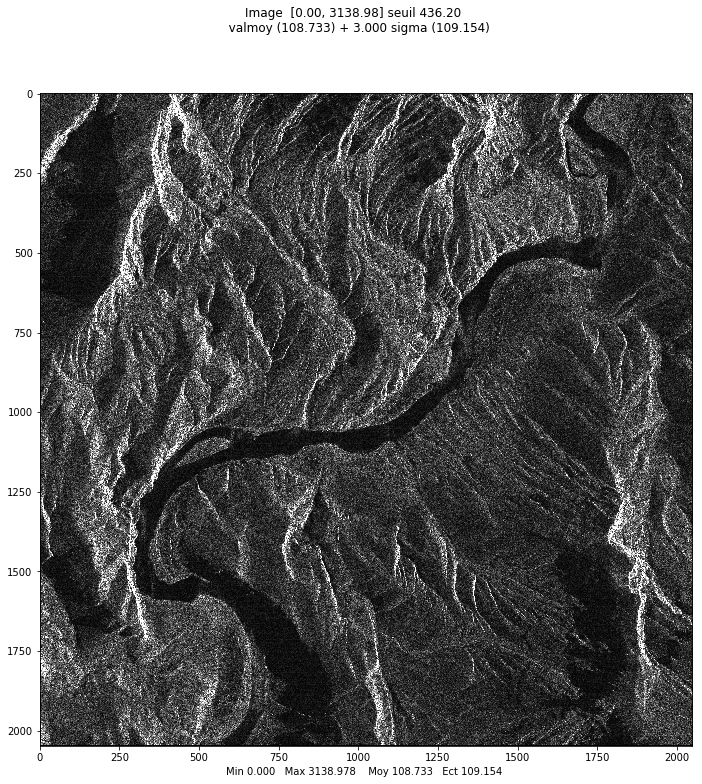

Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


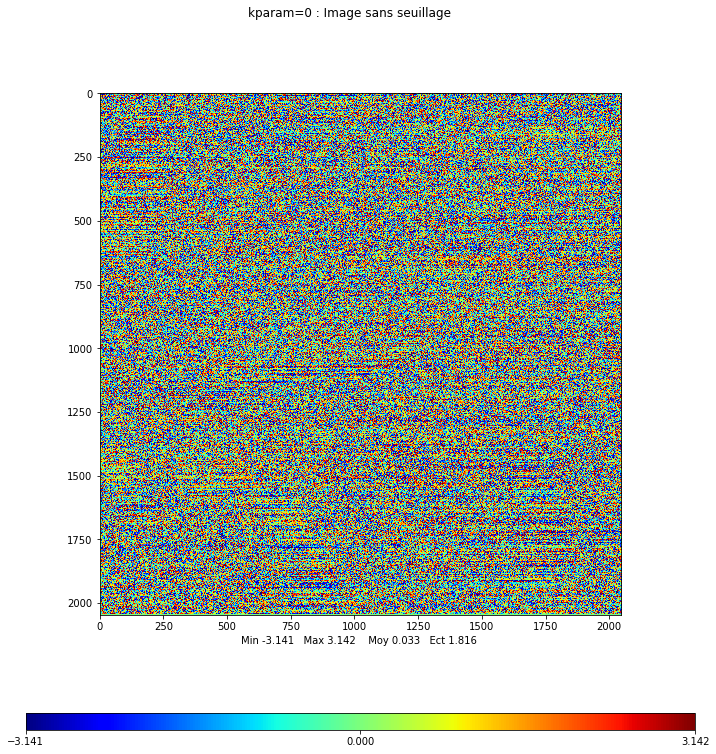

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2048 x 2048


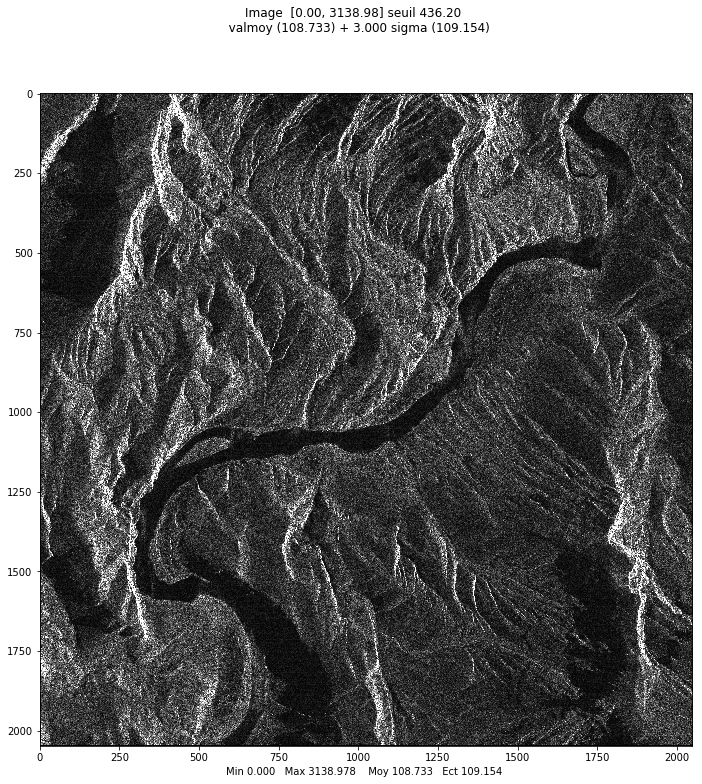

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2048 x 2048


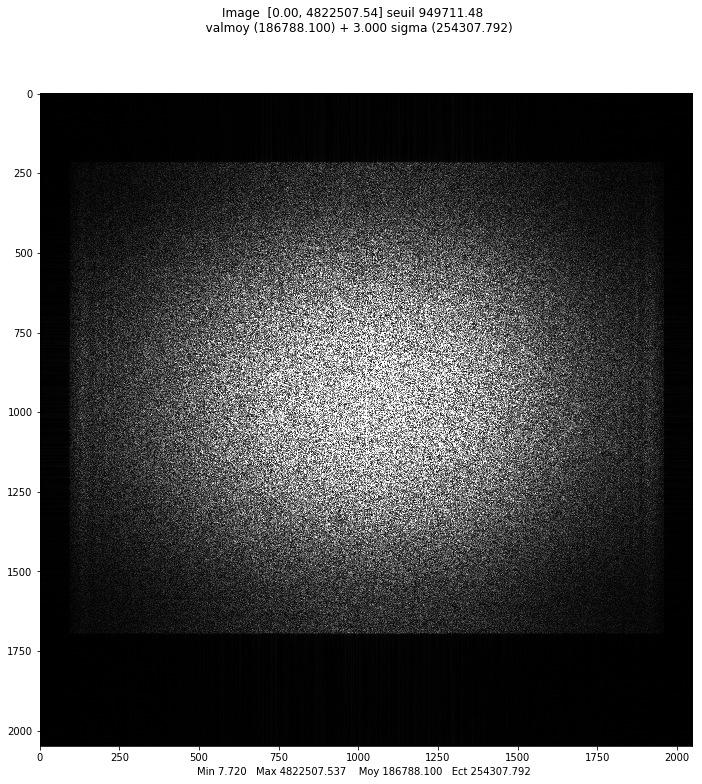

In [5]:
mvalab.visusar(tableauimage)
mvalab.visuinterfero(npy.angle(tableauimage),0)
mvalab.visusarspectre(tableauimage)

### Terrasar-X data on Grand Canyon (Airbus)

##### Parameters values for the TerraSAR-X data 
These are free data provided by Airbus of Grand Canyon, Colorado, US. 
The parameters of the sensor for this acquisition are the following:
- $\theta = 39.15^{\rm o}$  (for the master image)
- $R$ = 646 km  (hypothesis of spheric earth)
- $\lambda$ = 3.11 cm
- $B_{ortho}$ = 46.5 m
- $F_e$ = 109.89 MHz

What is the size of a ground range cell ? 

$\textbf{Size of ground range cell: } \frac{c}{2 F_e \sin \theta}$


These values will be used in the following to compute the contribution of the phase ramp corresponding to the orbital fringes. 

##### Registration of the two original SAR images 
The two images to consider are the following:
- TSX_GC_maitre.cxs
- TSX_GC_esclave.cxs



imz2mat : version janvier 2018.  Fichier à ouvrir : https://perso.telecom-paristech.fr/nicolas/MVA/SEANCE14fevrier/images/TSX_GC_maitre.cxs
Nom compatible url
Nom compatible url
Complex short, Fichiers Unix
INFO - reading header/dim : https://perso.telecom-paristech.fr/nicolas/MVA/SEANCE14fevrier/images/TSX_GC_maitre.dim
lecture .dim OK -> largeur:2048 hauteur:2048 profondeur:1
Debug 2 2 2048
2 2048 >h
imz2mat : version janvier 2018.  Fichier à ouvrir : https://perso.telecom-paristech.fr/nicolas/MVA/SEANCE14fevrier/images/TSX_GC_slave.cxs
Nom compatible url
Nom compatible url
Complex short, Fichiers Unix
INFO - reading header/dim : https://perso.telecom-paristech.fr/nicolas/MVA/SEANCE14fevrier/images/TSX_GC_slave.dim
lecture .dim OK -> largeur:2048 hauteur:2048 profondeur:1
Debug 2 2 2048
2 2048 >h
Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2048 x 2048


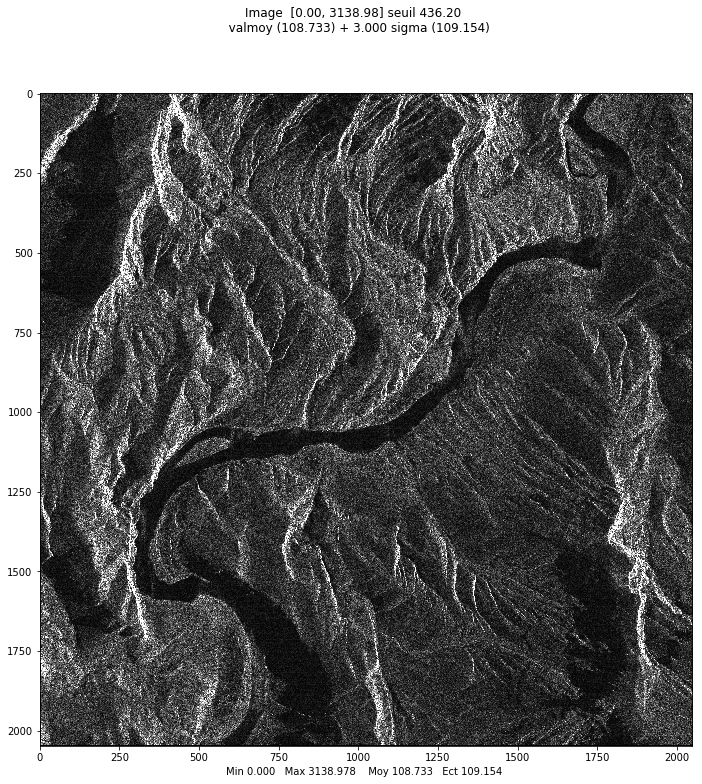

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2048 x 2048


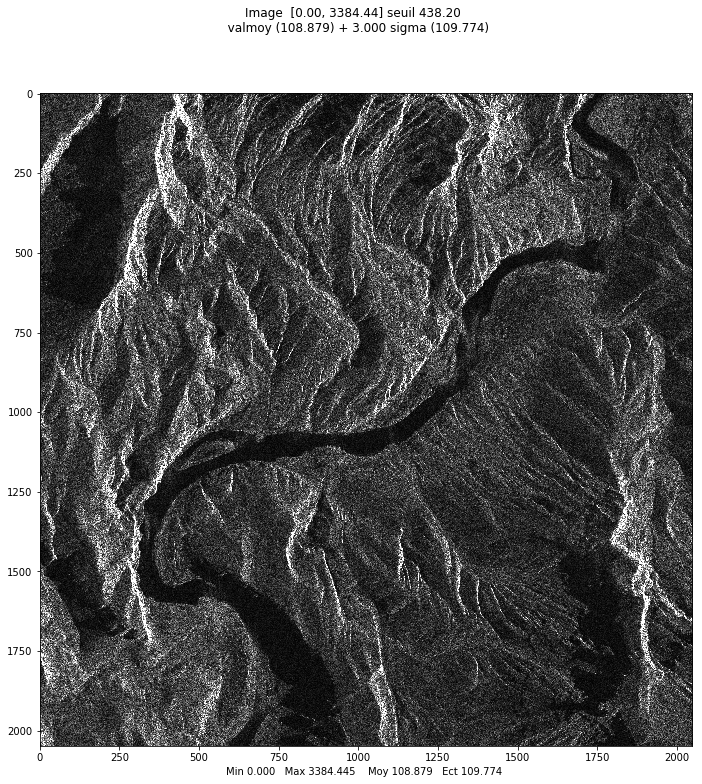

array([[  0.        ,  66.61080993,  22.20360331, ..., 131.487642  ,
        148.33745313,  88.52683209],
       [  0.        ,  36.76955262,  19.02629759, ..., 106.06601718,
        261.72504657, 293.12795841],
       [  0.        ,  78.23042886,  53.07541804, ...,   9.8488578 ,
        171.95929751, 314.24990056],
       ...,
       [  0.        ,  41.59326869,  92.76313923, ...,  94.5409964 ,
        177.07907838, 205.50669089],
       [  0.        ,  75.10659092, 159.76545309, ...,  58.00862005,
        138.3220879 , 213.97429752],
       [  0.        ,   0.        ,   0.        , ...,   0.        ,
          0.        ,   0.        ]])

In [2]:
url='https://perso.telecom-paristech.fr/nicolas/MVA/SEANCE14fevrier/images/'
imamaitre=mvalab.imz2mat(url+'TSX_GC_maitre.cxs')
imaslave = mvalab.imz2mat(url+'TSX_GC_slave.cxs')
mvalab.visusar(imamaitre[0])
mvalab.visusar(imaslave[0])

These images are complex images. 
They are given in their original geometry of acquisition. 
Thus, they are not directly super-imposable. 
You can flicker them using *mvalab.visuflicker* (you have to use spyder)
on a chosen window:
*
mvalab.visuflicker(imamaitre[0][200:400,200:400],imaslave[0][200:400,200:400])
*

To do a registration at the pixel scale, you can find the maximum of the correlation between the two amplitude images.
This is done in the Fourier domain by computing the hermitian product of the two Fourier transforms.
Then the inverse Fourier tansform gives the correlation image. 

Compute the translation to apply and give its value.
Then compute the interferogram by computing the hermitian product between the two registered images (pixel by pixel, 1-look interferogram). What do you see ?

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2048 x 2048


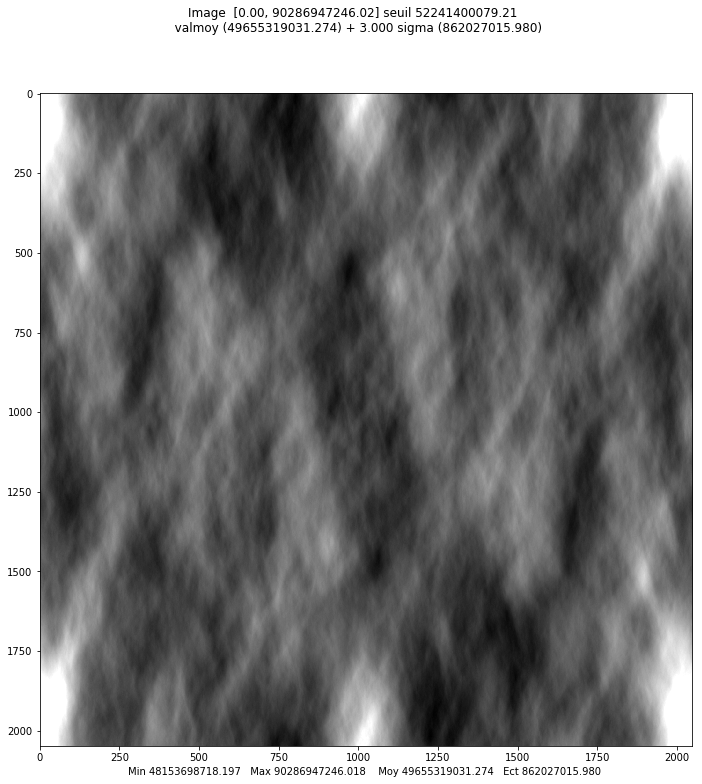

Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


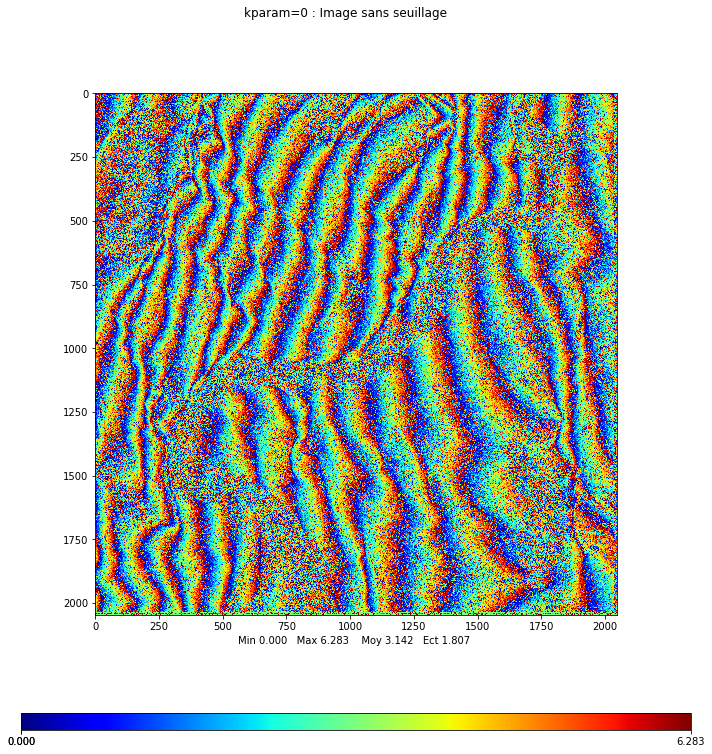

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2048 x 2048


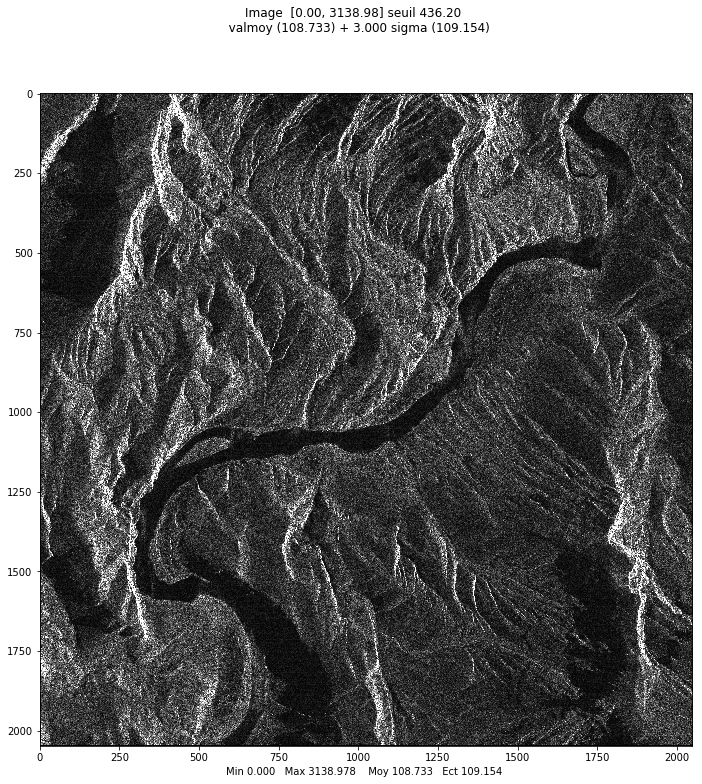

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2048 x 2048


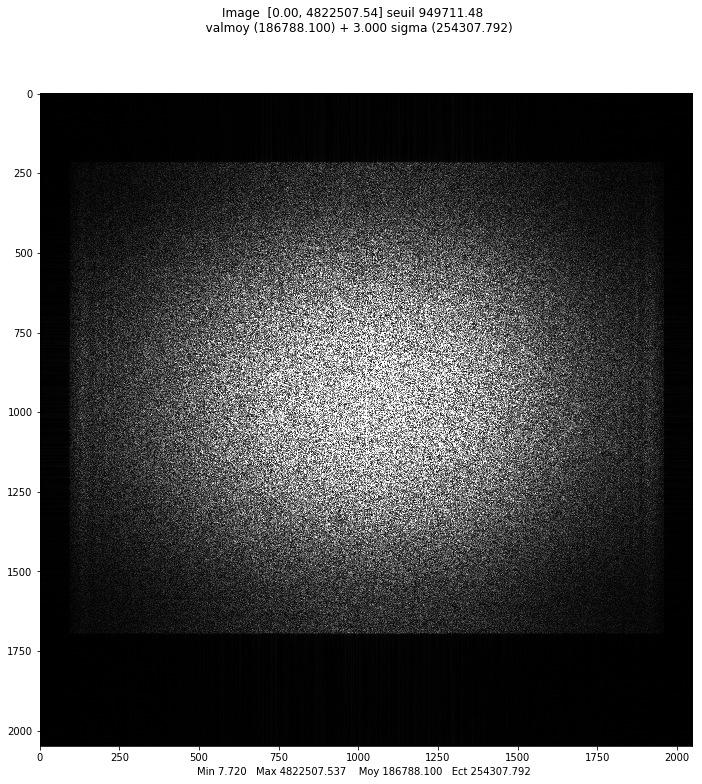

In [6]:
ima1fft=npy.fft.fft2(npy.abs(imamaitre[0]))
ima2fft=npy.fft.fft2(npy.abs(imaslave[0]))

imacorfft = npy.multiply(ima1fft, npy.conjugate(ima2fft))
imacor=npy.fft.ifft2(imacorfft)

mvalab.visusar(imacor)

idecalage=npy.unravel_index(npy.argmax(npy.abs(imacor)), imacor.shape)
#
imaslaveroll=npy.roll(imaslave[0], idecalage[0], axis=0)
imaslaveroll=npy.roll(imaslaveroll, idecalage[1], axis=1)

interfero=npy.multiply(imamaitre[0], npy.conj(imaslaveroll) )
mvalab.visuinterfero(npy.angle(interfero)+math.pi,0)
mvalab.visusarspectre(imamaitre[0])

##### Sub-pixellic registration and orbital fringe correction
The two images are almost registered but in practice the ground cells are slightly different since they have not been taken under the exact same incidence angle.  
The formula giving the ground cell size are:
$\Delta x_M =  \frac{c}{2 \: F_e \: \sin \theta}$
and 
$\Delta x_S =  \frac{c}{2 \: F_e \: \sin \left(\theta + \delta \theta\right)}$

$\delta \theta$ being known thanks $B_{ortho}$ and $R$. 

We know that $sin(\delta \theta) \approx \delta \theta$ since $\delta \theta$ is small

What do you think of the ground cells difference ? What is the value ?

What is the ratio with the "ground wavelength"  $\lambda_{sol}=\frac{\lambda}{\sin \theta}$ ?

What is the corresponding range difference in the line of sight ? To which phase shift does it correspond (taking into account the round-trip of the wave) $\delta \phi = \frac{4\pi \delta R}{\lambda}$? 

This phase shift corresponds to one pixel, what is the global phase shift between near range and far range for the whole image ? Check on the previous interferometric phase image that the number of fringes is in accordance with your value.

To take into account this phase shift for each pixel, apply a phase shift, dephasage being the whole phase shift for the number of pixels in range of the image.

*rampephase=npy.linspace(0.,dephasage,ncolonnes)*

*malignephase=npy.exp(1jrampephase)*

*imaslavefine=npy.multiply(imaslaveroll,malignephase)*

$\textbf{Computation:}$

First we note that by the small-angle approximation, $\sin \delta \theta \approx \delta \theta = \frac{B_{ortho}}{R}$. We can then compute $\Delta x_M - \Delta x_S =  \frac{c}{2 F_e \sin \theta} - \frac{c}{2 F_e \sin (\theta + \delta \theta)}$ by bringing the terms into a single fraction with a common denominator: $\frac{c}{2F_e} \frac{\sin(\theta + \delta \theta) - \sin \theta}{\sin \theta \cdot \sin(\theta + \delta \theta)}$. We use two approximations, the first-order Taylor expansion $\sin(\theta + \delta \theta) \approx \sin(\theta) + \delta \theta \cos(\theta)$ on the numerator, and the simple recognition that $\delta \theta$ is small so that in the denominator $\sin (\theta + \delta \theta) \sin(\theta) \approx \sin^2(\theta)$ (since the angle is 30 something degrees and the deviation is tiny this changes the value little). Then we have that the ground cell difference is $\Delta x = \frac{c}{2F_e} \frac{\delta \theta}{\sin \theta \cdot \tan \theta}$.

This produces a range difference of $\Delta r = \Delta x \sin \theta \approx \frac{c}{2F_e} \frac{\delta \theta}{\tan \theta}$.

Thus the phase shift is $\delta \phi = \frac{2\pi}{\lambda} \frac{c}{F_e} \frac{\delta \theta}{\tan \theta}$.





In [7]:
c = 299792458
Fe = 109890000
Borth = 46.5
theta = 39.15*(2*math.pi)/360.0
R = 646000
delta_theta = Borth/R
lambda_ = 0.0311
# without the approximations
delta_sol = (c/(2*Fe)) * (npy.cos(theta+delta_theta)*delta_theta)/(npy.sin(theta+delta_theta)*npy.sin(theta))
delta_range = delta_sol*npy.sin(theta)
delta_phi = 4*math.pi*delta_range/lambda_
print("without approximations: ", delta_phi*2048)
delta_phi_approx_per_cell = (4*math.pi*c*delta_theta)/(lambda_*2*Fe*npy.tan(theta))
print("with approximations: ", delta_phi_approx_per_cell*2048)

dephasage = 99.671602

ncolonnes=imamaitre[1]

rampephase=npy.linspace(0.,dephasage,ncolonnes)

malignephase=npy.exp(1j*rampephase)

imaslavefine=npy.multiply(imaslaveroll,malignephase)


without approximations:  99.78743483193004
with approximations:  99.80210618672292


To compute now the interferometric product, you have to compute the multi-look hermitian product given by the formula :

$d(i,j)= {\gamma(i,j) e}^{j \phi(i,j)}$

$d(i,j)=\frac{\sum_{(i',j') \in {{V}}(i,j)} I_m(i',j')I_s^*(i',j')}
{
\sqrt{\sum_{(i',j') \in {{V}}(i,j)} I_m(i',j')I_m^*(i',j')} 
\sqrt{\sum_{(i',j') \in {{V}}(i,j)} I_s(i',j')I_s^*(i',j')} } 
$

the usual neighborhood is a square of size 3$\times$3 pixels. 
It gives :
- the interferometric phase (argument of the output, $\phi(i,j)$)
- the coherence (modulus of the output $\gamma(i,j)$ ) reflecting the quality of the interferometric phase

Compute and compare the interferometric product for the two images (master and slave), with and without the sub-pixellic phase shift. 

You can fill the python program filtrage.py to compute this fuction.


Hi
(2048, 2048)
(2048, 2048)
Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


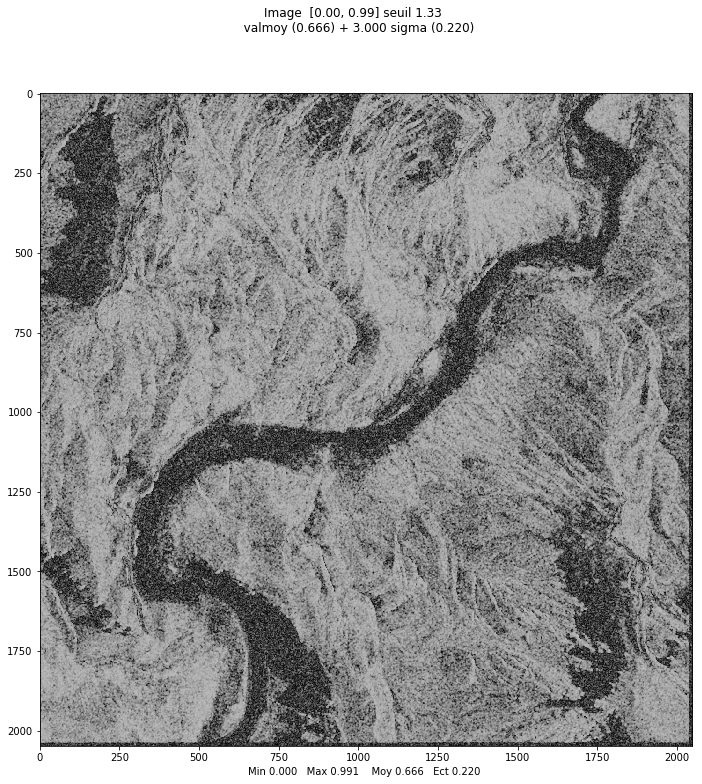

Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


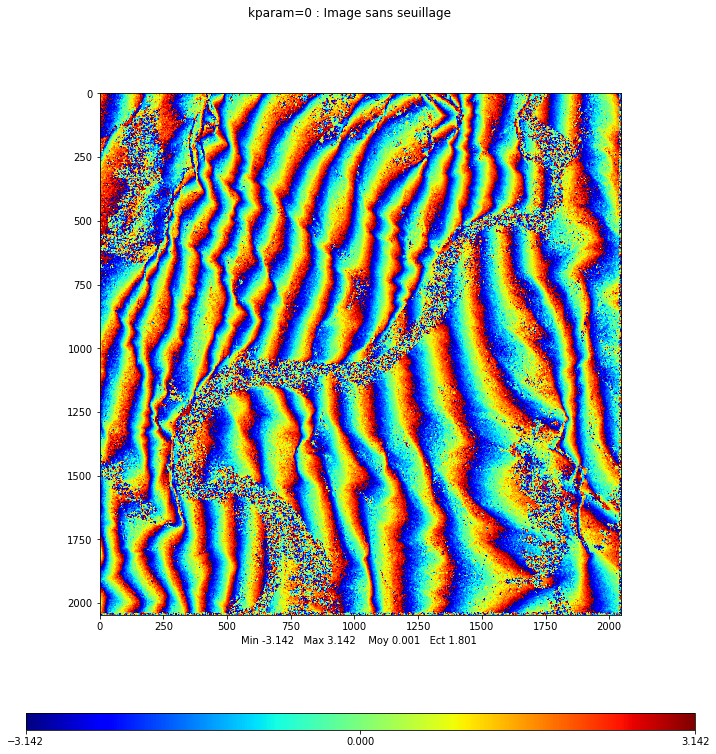

array([[ 1.44983767,  1.19058154,  1.41054187, ..., -1.683623  ,
        -1.70348485, -1.6700767 ],
       [ 1.52455283,  1.42180586,  1.74544021, ..., -1.68037734,
        -1.63175821, -1.66903   ],
       [ 1.74397338,  1.8678086 ,  1.80630985, ..., -1.60579957,
        -1.47327706, -1.66184794],
       ...,
       [ 2.70652299, -3.04712568,  2.67689054, ...,  1.21941782,
         1.32660359,  0.90603273],
       [ 2.626404  , -3.09777382,  2.99030503, ...,  0.56865644,
         0.63953175,  0.96312909],
       [ 2.74649472, -3.0593014 ,  3.02142441, ...,  1.04507579,
         1.76967114,  1.70618367]])

In [8]:
import filtrage
# you have to complete filtrage to do the complex multi-looking


# The image after alignment via correlation/match filter
interf=filtrage.interferogramme(imamaitre[0], imaslaveroll)

mvalab.visusar(npy.abs(interf))
mvalab.visuinterfero(npy.angle(interf),0)

Hi
(2048, 2048)
(2048, 2048)
Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


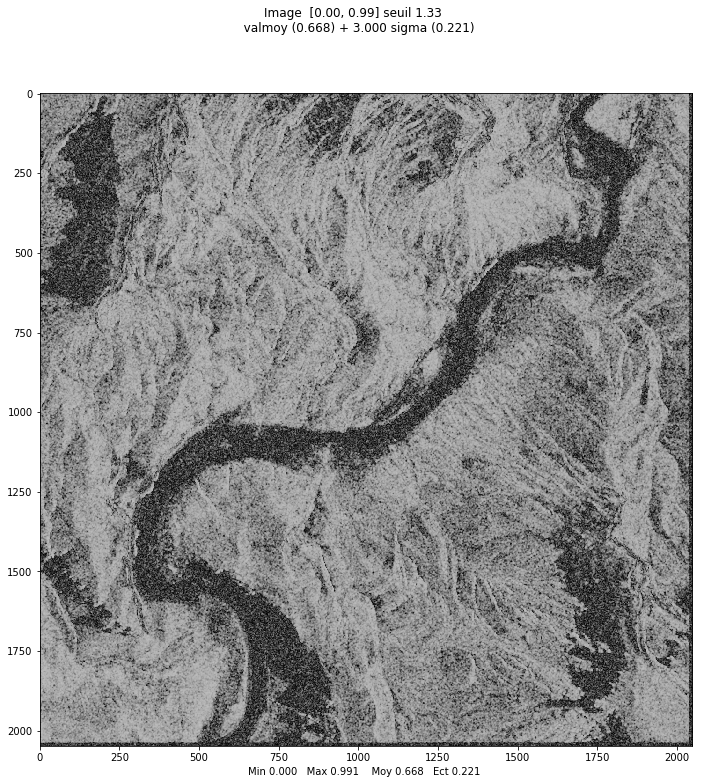

Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


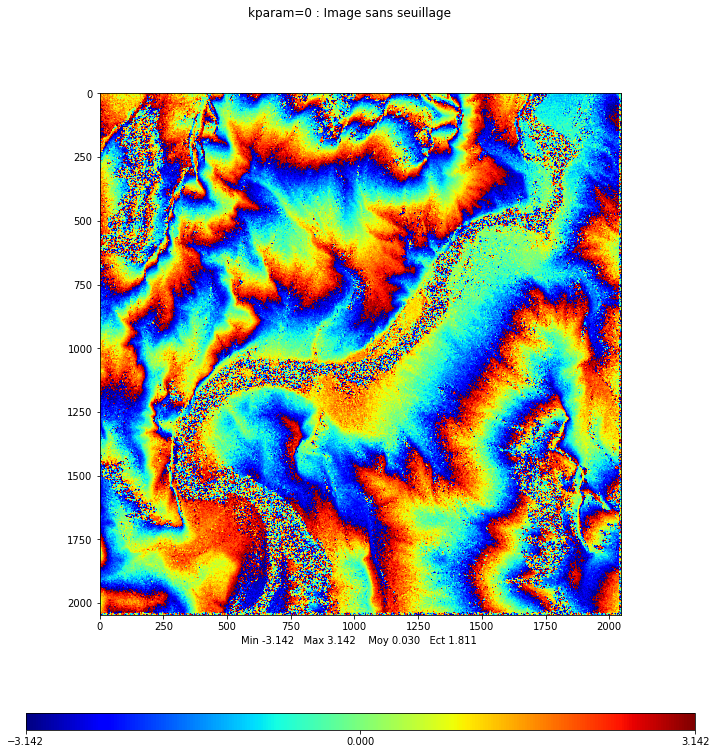

array([[ 1.35245457,  1.07399086,  1.26763934, ..., -0.74193411,
        -0.80983086, -0.77476219],
       [ 1.42716973,  1.31073325,  1.58690451, ..., -0.74692347,
        -0.74412407, -0.77618115],
       [ 1.64659028,  1.74451559,  1.63899653, ..., -0.66738802,
        -0.58488759, -0.76762816],
       ...,
       [ 2.62212353,  3.12565467,  2.54326083, ...,  2.1645727 ,
         1.98402816,  1.76291387],
       [ 2.5308123 ,  3.0658121 ,  2.86346297, ...,  1.58967708,
         1.38236945,  1.87027162],
       [ 2.64919103,  3.09654679,  2.88495659, ...,  2.04213132,
         2.77110649,  2.67117801]])

In [9]:
# subpixel alignment

interfnoramp=filtrage.interferogramme(imamaitre[0], imaslavefine)

mvalab.visusar(npy.abs(interfnoramp))
mvalab.visuinterfero(npy.angle(interfnoramp),0)

A direct re-sampling of the slave image in the master geometry is also possible. In this case, the size of the cells is exactly the same as the master image. 

Download the image *TSX_GC_slave_recalee* and compute the interferogram as previously. 
What do you observe ? 

imz2mat : version janvier 2018.  Fichier à ouvrir : https://perso.telecom-paristech.fr/nicolas/MVA/SEANCE14fevrier/images/TSX_GC_slave_recalee.cxs
Nom compatible url
Nom compatible url
Complex short, Fichiers Unix
INFO - reading header/dim : https://perso.telecom-paristech.fr/nicolas/MVA/SEANCE14fevrier/images/TSX_GC_slave_recalee.dim
lecture .dim OK -> largeur:2048 hauteur:2048 profondeur:1
Debug 2 2 2048
2 2048 >h
Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2048 x 2048


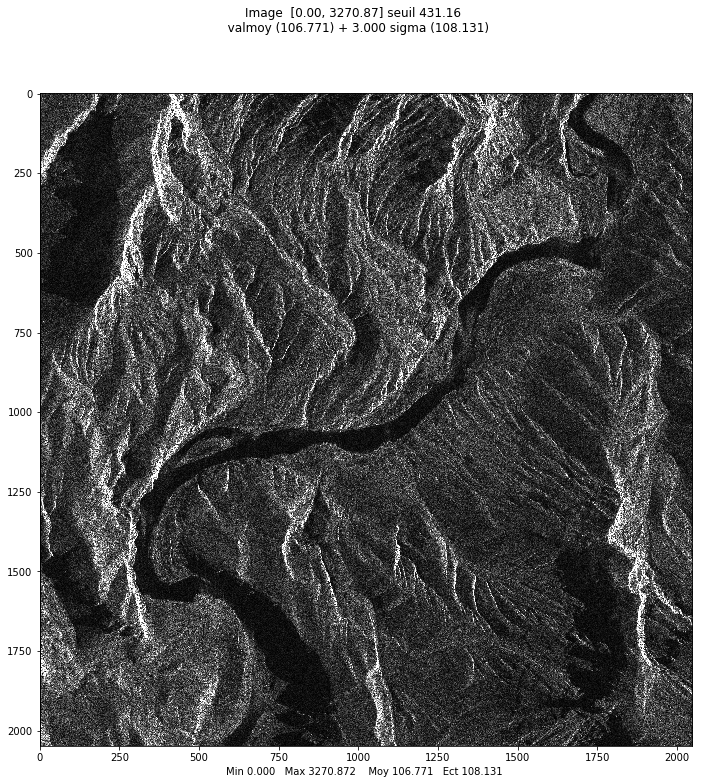

Hi
(2048, 2048)
(2048, 2048)
Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


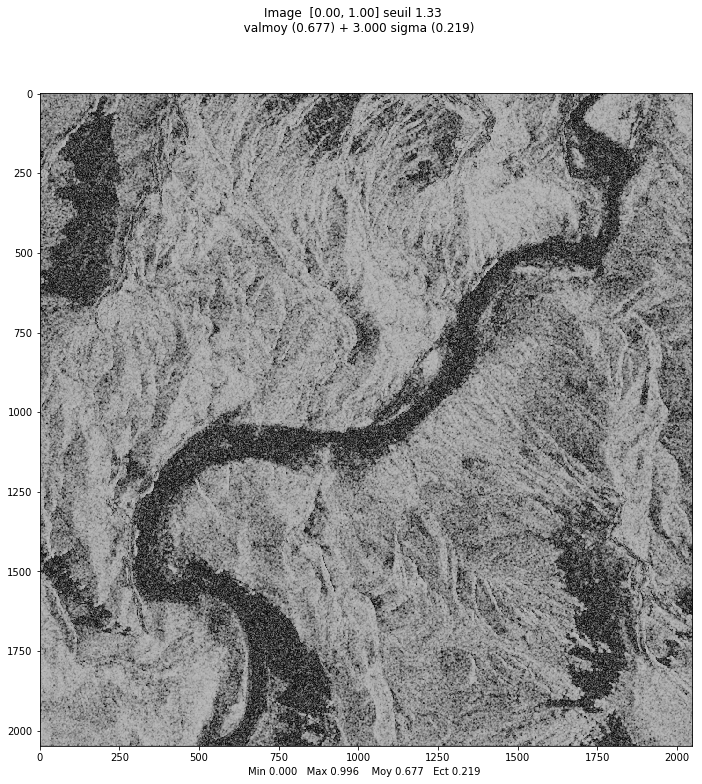

Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


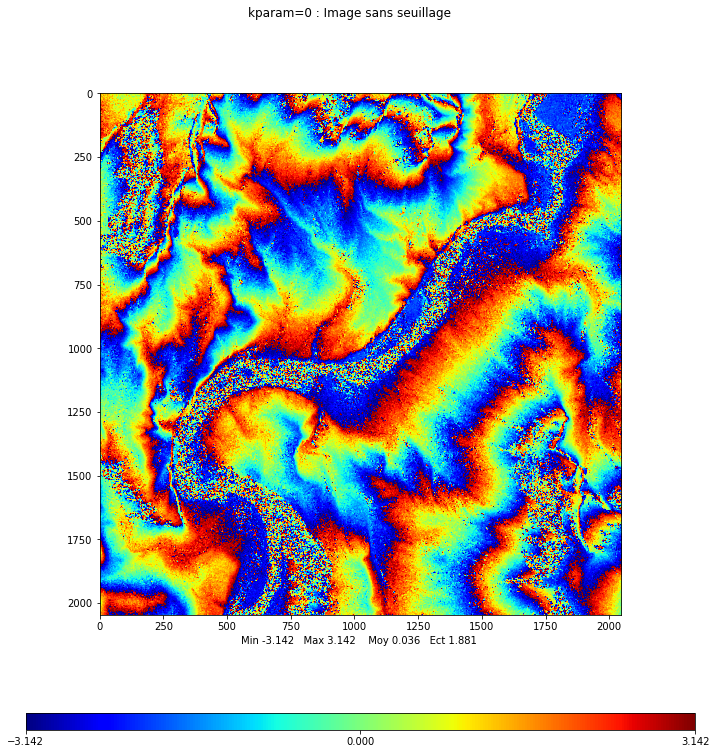

array([[ 1.08181665,  0.85119476,  1.00133003, ..., -2.35773306,
        -2.28941601, -2.31855867],
       [ 1.17627925,  1.1178121 ,  1.3261941 , ..., -2.33594703,
        -2.26593377, -2.29537611],
       [ 1.38007332,  1.4997962 ,  1.35876629, ..., -2.31313701,
        -2.22196255, -2.25843014],
       ...,
       [ 2.11035463,  1.12293457,  1.26090261, ...,  0.07513957,
        -0.02631822, -0.09714755],
       [ 2.30697633,  1.22492641,  1.44350165, ...,  0.0282127 ,
        -0.00853584, -0.14186208],
       [-0.24683051,  1.27401787,  1.45940669, ..., -0.07659097,
        -0.23560592, -0.2521746 ]])

In [10]:
#processing of the registered image 

imaslave_recalee = mvalab.imz2mat(url+'TSX_GC_slave_recalee.cxs')
mvalab.visusar(imaslave_recalee[0])

interfrecal=filtrage.interferogramme(imamaitre[0], imaslave_recalee[0])

mvalab.visusar(npy.abs(interfrecal))
mvalab.visuinterfero(npy.angle(interfrecal),0)

In [15]:
hamb = lambda_*R*npy.sin(theta)*0.5/Borth
print("h_amb", hamb)
print("height", 5*hamb)

h_amb 136.3898545403792
height 681.949272701896


##### Interpreting the fringes

When taking into account the phase shift due to pixel size differences, what do the left fringes 
correspond to ? 

$\textbf{Fringes:}$ Each fringe (complete color cycle) corresponds to an elevation change of $h_{amb}$ the height difference corresponding to a full cycle of $2 \pi$ in phase shift. 

Compute the ambiguity height given by :
    
$h_{amb} = \frac{\lambda R \: \sin \theta}{ 2 B_{ortho} }$

Which mean depth of the Grand Canyon can be deduced from the interferogram ? Explain. 

$\textbf{Height:}$ We see about 5 fringes so we can estimate the Grand Canyon's height at $5 \cdot h_{amb}$. This is computed above as about 136 m for the h_amb and 682 m for the total height

## ERS data of Etna (SARedu data)

The following parameters have to be used for these data:
- $\theta = 20^{\rm o}$ (on est en ``near range'')
-  $R$ = 826 km  (hypothèse de Terre sphérique)
-  $\lambda$ = 5.66 cm
-  $B_{ortho}$ = -54.5 m
-  $F_e$ = 18.96 MHz

Do the same processing as before with these new data. 

What is the pixel phase shift in this case ? 

What is the ambiguity height ? 

Which altitude do you find for Etna mount using your interferogram ? (explain)

Which are the areas of low coherence ? Explain why.

$\textbf{Calculations: }$ Dephasage: approx 652 pixels. Ambiguity height: approx 147 m. Height of the mountain: approximately 20 fringes (perhaps a few more -- it's hard to see near the top of the mountain as the ambiguity height is attained so quickly due to the steepness). Thus the height of the mountain is very roughly 3000 m (perhaps + a couple multiples of 147 m). This is assuming the body of water is at sea level (see below).

$\textbf{Low coherence: }$ The areas of low coherence are the areas with poor fringe quality, i.e. the area near the top of the peak and the water body to the right of the scene. Coherence is a sort of measure of the match between the two images. It's the expected value of the first image times the conjugate of the second, normalized. When the phases are pretty random, the numerator of the coherence will be the product of the two images' magnitudes times $exp($the phase difference), which is varying randomly over a $2 \pi$ interval, producing positive contributions here and negative contributions there. Thus the expected value -- the coherence -- is low. This happens, for instance, in bodies of water, which contain ripples or which fail to reflect much of the signal back at the satellite: what one observes is noise. This can also happen on very steep and jaggedy cliff faces near a mountaintop. The fringes are small here because the mountain is so steep the ambiguity height is attained within very few pixels. Near the very top the SNR is low though perhaps not as low as it is over the worst part of the water.

In [23]:
c = 299792458
Fe = 18960000
Borth = -54.5
theta = 20*(2*math.pi)/360.0
R = 826000
delta_theta = Borth/R
lambda_ = 0.0566

delta_sol = (c/(2*Fe)) * (npy.cos(theta+delta_theta)*delta_theta)/(npy.sin(theta+delta_theta)*npy.sin(theta))
delta_range = delta_sol*npy.sin(theta)
delta_phi = 4*math.pi*delta_range/lambda_
print("dephasage without approximations: ", delta_phi*2048)
delta_phi_approx_per_cell = (4*math.pi*c*delta_theta)/(lambda_*2*Fe*npy.tan(theta))
print("dephasage with approximations: ", delta_phi_approx_per_cell*2048)

hamb = lambda_*R*npy.sin(theta)*0.5/Borth
print("h_amb: ", hamb)
print("height: ", 20*hamb)


dephasage without approximations:  -651.8017344170553
dephasage with approximations:  -651.6679258139778
h_amb:  -146.69714617159937
height:  -2933.9429234319873


/home/maxdunitz/Desktop/MVA/remotesensing/etna/
Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2000 x 5200


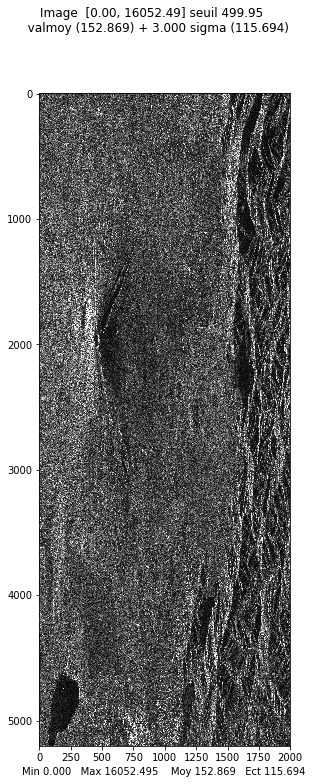

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2000 x 5200


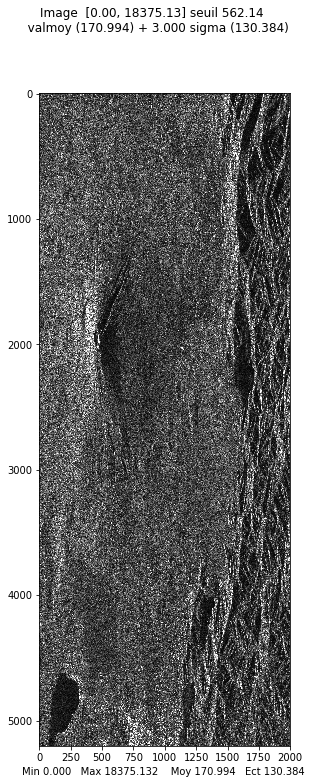

array([[111.25196627, 148.39474384, 328.95136419, ..., 125.60254774,
        315.22055771, 110.53506231],
       [127.90621564,  58.54912467, 158.14234095, ...,  42.        ,
        172.185946  , 112.29425631],
       [ 75.        ,  57.30619513, 114.38968485, ..., 254.18890613,
         90.47098983, 158.02847845],
       ...,
       [ 92.19544457, 144.47491132, 180.67927385, ...,  67.67569726,
        164.20109622,  57.42821606],
       [215.76144234, 111.87939935, 169.49926254, ...,  17.02938637,
         48.10405388,  35.51056181],
       [203.57799488,  81.04319836, 266.58019431, ...,  13.41640786,
         20.61552813,  34.40930107]])

In [18]:
# use the previous steps to process Etna data
repertoireMAT='/cal/homes/nicolas/public_html/MVA/SEANCE14fevrier/'
import os 
repertoireMAT = os.getcwd() + "/etna/"
print(repertoireMAT)
imageM='Master.mat'
imageS='Slave.mat'
imamaitre=mvalab.matlab2imz('/home/maxdunitz/Desktop/MVA/remotesensing/etna/Master.mat','Master')
imaslave=mvalab.matlab2imz('/home/maxdunitz/Desktop/MVA/remotesensing/etna/'+imageS,'Slave')

ncolonnes=imamaitre[1]
nlignes=imamaitre[2]

#%%

mvalab.visusar(imamaitre[0])
mvalab.visusar(imaslave[0])

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2000 x 5200


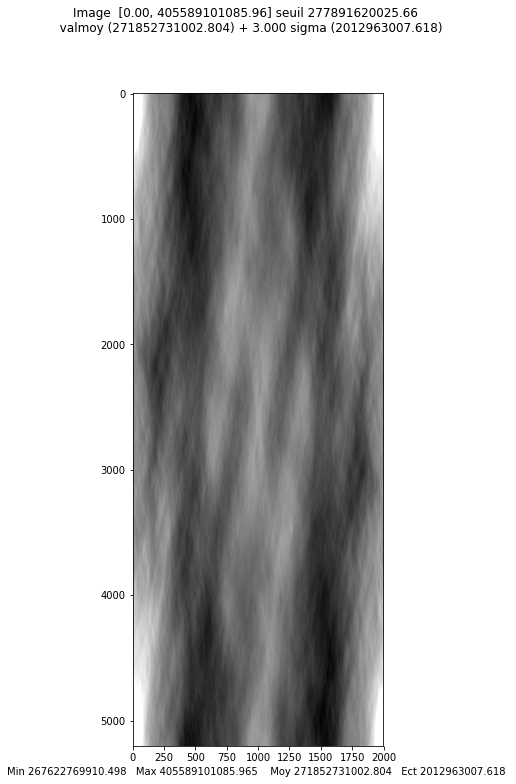

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 5200


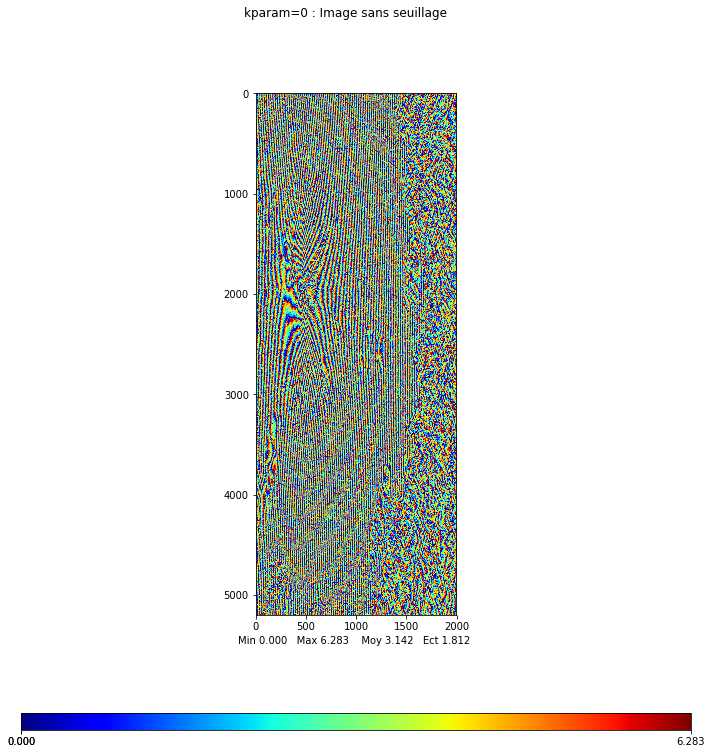

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2000 x 5200


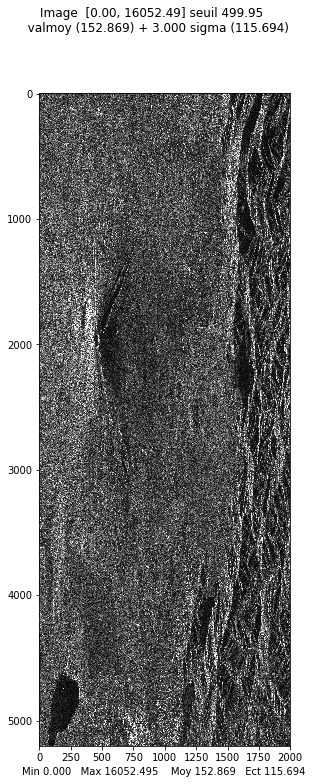

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2000 x 5200


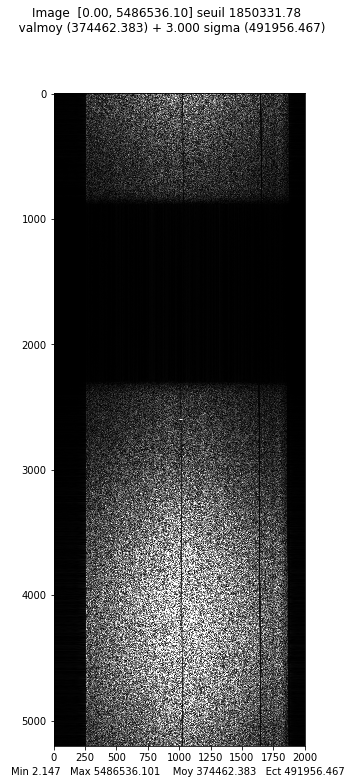

Hi
(5200, 2000)
(5200, 2000)


MemoryError: 

In [19]:
# correlation/matched filter for pixel alignment


ima1fft=npy.fft.fft2(npy.abs(imamaitre[0]))
ima2fft=npy.fft.fft2(npy.abs(imaslave[0]))

imacorfft = npy.multiply(ima1fft, npy.conjugate(ima2fft))
imacor=npy.fft.ifft2(imacorfft)

mvalab.visusar(imacor)

idecalage=npy.unravel_index(npy.argmax(npy.abs(imacor)), imacor.shape)
#
imaslaveroll=npy.roll(imaslave[0], idecalage[0], axis=0)
imaslaveroll=npy.roll(imaslaveroll, idecalage[1], axis=1)

interfero=npy.multiply(imamaitre[0], npy.conj(imaslaveroll) )
mvalab.visuinterfero(npy.angle(interfero)+math.pi,0)
mvalab.visusarspectre(imamaitre[0])


Hi
(5200, 2000)
(5200, 2000)
Affichage d'une image reelle
plt.show dans visusar : image 2000 x 5200


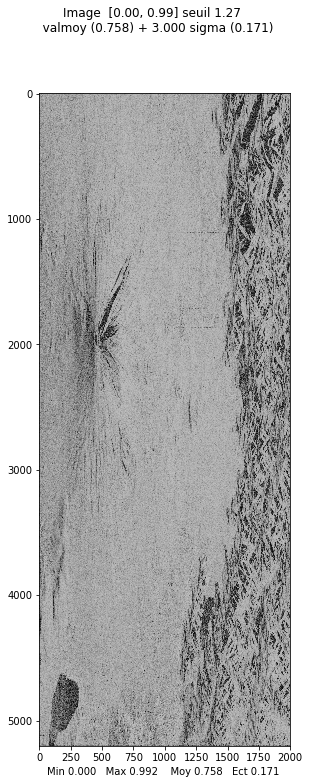

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 5200


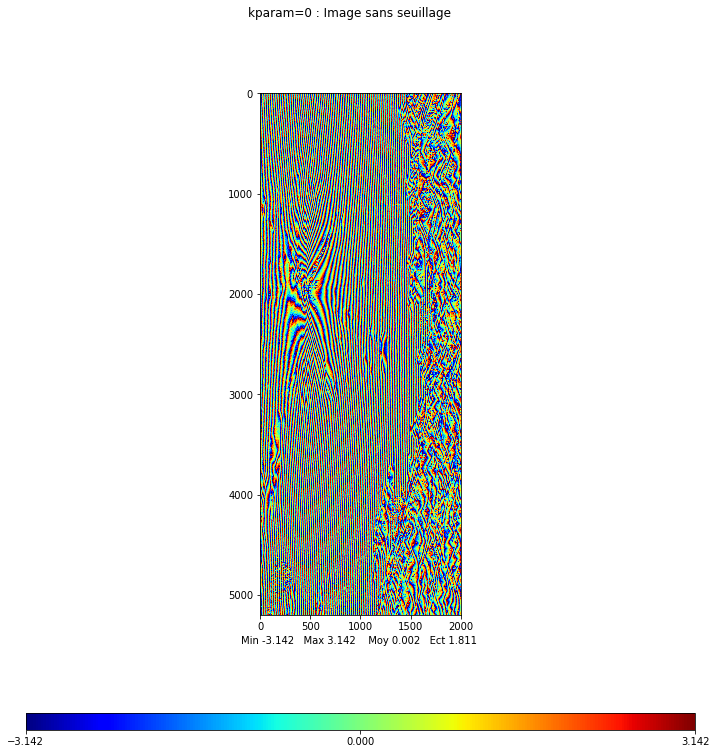

array([[-1.05714861, -0.83574453, -0.75458034, ...,  3.01738618,
        -2.83522407, -2.63475662],
       [-0.86075057, -0.75482842, -0.70963593, ...,  2.98899058,
        -2.9454991 , -2.59909492],
       [-0.86602388, -0.61274559, -0.59897514, ...,  3.06032169,
        -2.86378893, -2.4900249 ],
       ...,
       [-0.44520986, -0.23457279,  0.27541627, ...,  1.26374889,
         1.38627191,  0.58009325],
       [-0.4571063 , -0.0269131 ,  0.62430101, ...,  1.53583376,
         1.70470487, -1.26946866],
       [-0.5438766 , -0.33147239,  0.58219651, ...,  2.11612085,
         1.89812174, -1.1124395 ]])

In [21]:
# computed dephasage from above cell

dephasage = delta_phi*ncolonnes

# subpixel phase alignment

rampephase=npy.linspace(0.,dephasage,ncolonnes)
malignephase=npy.exp(1j*rampephase)
imaslavefine=npy.multiply(imaslaveroll,malignephase)

# interferrogram from the rough (correlation/matched/pixelwise) alignment
interf=filtrage.interferogramme(imamaitre[0], imaslaveroll)

mvalab.visusar(npy.abs(interf))
mvalab.visuinterfero(npy.angle(interf),0)




Hi
(5200, 2000)
(5200, 2000)
Affichage d'une image reelle
plt.show dans visusar : image 2000 x 5200


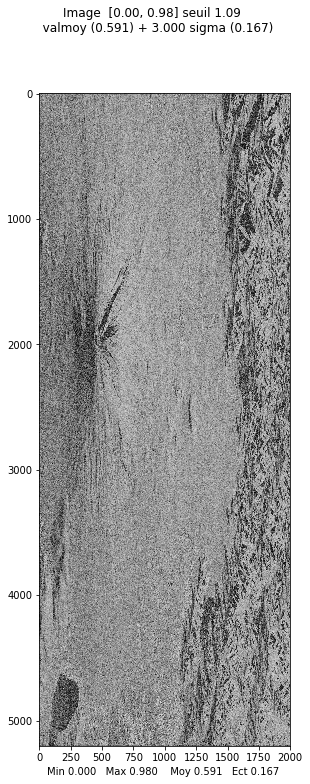

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 5200


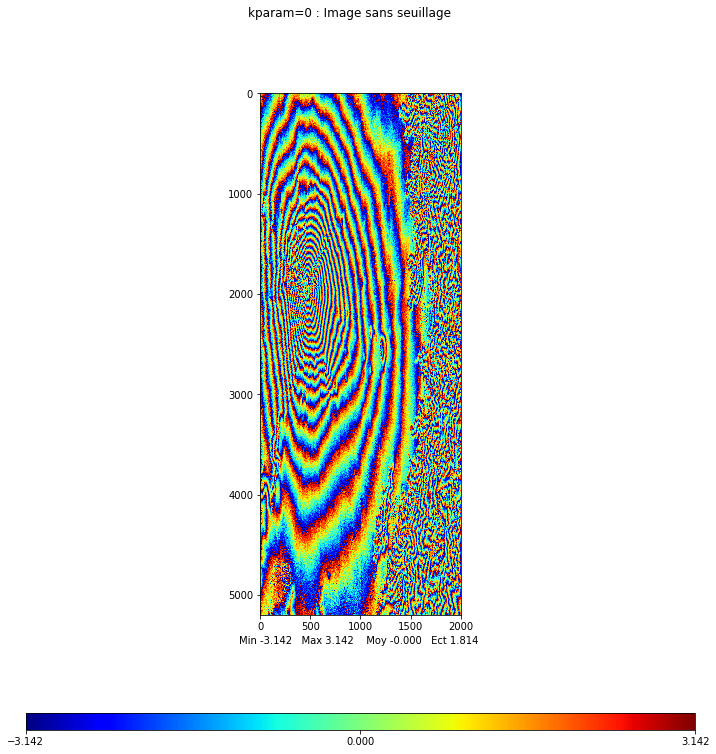

array([[-0.80995764, -0.06884907,  0.26686537, ..., -2.36101913,
        -1.42636114, -1.03721352],
       [-0.4278621 ,  0.01444682,  0.26590371, ..., -2.42090349,
        -1.60957067, -1.00580611],
       [-0.38376701,  0.208989  ,  0.36905008, ..., -2.35261541,
        -1.50649837, -0.89179789],
       ...,
       [-0.19458335, -0.07424412,  0.95166927, ...,  2.31181105,
         2.29244439,  1.91152313],
       [-0.24794241, -0.22076117,  0.69750489, ...,  2.0975916 ,
         1.36417721,  0.50051231],
       [-0.27119307, -0.40246416, -1.43070519, ...,  2.32227759,
         1.3469607 ,  0.64719627]])

In [22]:
# interferrogram from the fine alignment

interf=filtrage.interferogramme(imamaitre[0], imaslavefine)

mvalab.visusar(npy.abs(interf))
mvalab.visuinterfero(npy.angle(interf),0)